# Stock Market Analysis - Top 10 Companies

## Project Overview

This project analyzes the historical stock prices of 10 major companies across different sectors from 2015 to present. The analysis includes data cleaning, exploratory data analysis, time series analysis, risk-return metrics, correlation analysis, and portfolio optimization.

**Companies Analyzed:**
- **AAPL** - Apple Inc. (Technology)
- **AMZN** - Amazon.com Inc. (E-commerce/Tech)
- **GOOGL** - Alphabet Inc. (Technology)
- **JNJ** - Johnson & Johnson (Healthcare)
- **JPM** - JPMorgan Chase & Co. (Financial Services)
- **META** - Meta Platforms Inc. (Technology/Social Media)
- **MSFT** - Microsoft Corporation (Technology)
- **NVDA** - NVIDIA Corporation (Technology/Semiconductors)
- **PG** - Procter & Gamble (Consumer Goods)
- **XOM** - Exxon Mobil Corporation (Energy)

**Key Objectives:**
- Analyze price trends and volatility
- Calculate returns and risk metrics
- Identify correlations between stocks
- Perform portfolio optimization
- Provide investment insights

**Author:** [Your Name]  
**Date:** February 2026

## 1. Import Libraries

In [1]:
%conda install pandas scikit-learn seaborn wordcloud plotly -c conda-forge textblob -c conda-forge nbformat

mambajs 0.19.13

Specs: xeus-python, numpy, matplotlib, pillow, ipywidgets>=8.1.6, ipyleaflet, scipy, pandas, scikit-learn, seaborn, wordcloud, plotly, textblob, nbformat
Channels: emscripten-forge, conda-forge

Solving environment...
Solving took 4.80729999999702 seconds
  Name                          Version                       Build                         Channel                       
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
+ __unix                        1.0.0                         hc286ada_0                    emscripten-forge              
+ attrs                         25.4.0                        pyhcf101f3_1                  conda-forge                   
+ brotli-python                 1.2.0                         py313h33caa6c_0               emscripten-forge              
+ certifi                       2026.1.4                      pyhd8ed1ab_0                  conda-forge           

In [2]:
# Data manipulation
import pandas as pd
import numpy as np
from datetime import datetime

# Visualization
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots

# Statistical analysis
from scipy import stats
from scipy.optimize import minimize

# Financial metrics
import warnings
warnings.filterwarnings('ignore')

# Settings
pd.set_option('display.max_columns', None)
pd.set_option('display.float_format', lambda x: '%.4f' % x)
plt.style.use('seaborn-v0_8-darkgrid')
sns.set_palette("husl")

print("✅ All libraries imported successfully!")

✅ All libraries imported successfully!


## 2. Load and Explore Data

In [3]:
# Load the dataset
df = pd.read_csv('Prices.csv')

print(f"Dataset shape: {df.shape}")
print(f"\nNumber of trading days: {df.shape[0]:,}")
print(f"Number of stocks: {df.shape[1] - 1}")  # Excluding Date column

Dataset shape: (2765, 11)

Number of trading days: 2,765
Number of stocks: 10


In [4]:
# Display first few rows
df.head(10)

,Date,AAPL,AMZN,GOOGL,JNJ,JPM,META,MSFT,NVDA,PG,XOM
0,2015-01-02,24.2375,15.4260,26.2789,76.9556,46.5111,77.9058,39.8585,0.4830,66.5183,57.9169
1,2015-01-05,23.5547,15.1095,25.7782,76.4181,45.0672,76.6545,39.4919,0.4749,66.2021,56.3322
2,2015-01-06,23.5570,14.7645,25.1420,76.0426,43.8987,75.6217,38.9123,0.4605,65.9005,56.0327
3,2015-01-07,23.8873,14.9210,25.0681,77.7213,43.9656,75.6217,39.4067,0.4593,66.2462,56.6005
4,2015-01-08,24.8051,15.0230,25.1554,78.3324,44.9481,77.6377,40.5660,0.4765,67.0038,57.5426
5,2015-01-09,24.8317,14.8465,24.8483,77.2648,44.1666,77.2007,40.2250,0.4785,66.3786,57.4615
6,2015-01-12,24.2198,14.5705,24.6666,76.9997,43.7870,76.1878,39.7221,0.4725,66.1359,56.3571
7,2015-01-13,24.4349,14.7370,24.9018,77.1323,43.7944,75.9197,39.5175,0.4717,66.4154,56.1513
8,2015-01-14,24.3417,14.6635,25.1068,76.5727,42.2835,75.7508,39.1765,0.4737,66.1874,55.9890
9,2015-01-15,23.6811,14.3475,25.0115,75.4609,40.9289,73.5363,38.7674,0.4703,66.0918,55.5024


In [5]:
# Data info
df.info()

<class 'pandas.DataFrame'>
RangeIndex: 2765 entries, 0 to 2764
Data columns (total 11 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   Date    2765 non-null   str    
 1   AAPL    2765 non-null   float64
 2   AMZN    2765 non-null   float64
 3   GOOGL   2765 non-null   float64
 4   JNJ     2765 non-null   float64
 5   JPM     2765 non-null   float64
 6   META    2765 non-null   float64
 7   MSFT    2765 non-null   float64
 8   NVDA    2765 non-null   float64
 9   PG      2765 non-null   float64
 10  XOM     2765 non-null   float64
dtypes: float64(10), str(1)
memory usage: 226.9 KB


In [6]:
# Basic statistics
df.describe()

,AAPL,AMZN,GOOGL,JNJ,JPM,META,MSFT,NVDA,PG,XOM
count,2765.0000,2765.0000,2765.0000,2765.0000,2765.0000,2765.0000,2765.0000,2765.0000,2765.0000,2765.0000
mean,106.2648,111.7142,93.6417,124.8933,119.2879,261.1139,206.0764,32.7589,107.6879,68.8243
std,74.2679,61.7017,57.4067,29.9922,65.7499,173.7683,143.2247,49.7869,36.7617,25.3363
min,20.6041,14.3475,24.6666,68.2788,40.4749,73.5363,34.4372,0.4593,51.2356,24.1451
25%,36.6487,50.1470,49.2211,103.2444,74.6272,141.2930,68.7811,3.7611,69.1111,52.5870
50%,88.4664,99.7410,73.2451,125.9807,99.1228,188.8409,191.9715,9.4944,108.8537,57.2001
75%,168.6325,163.2935,133.7162,149.4750,140.4799,321.9113,312.3666,29.3432,141.0799,96.3477
max,286.1900,254.0000,323.2286,214.1700,327.6919,788.8238,541.0574,207.0285,175.0745,120.9900


## 3. Data Cleaning and Preparation

### 3.1 Handle Date Column and Missing Values

In [7]:
# Create a copy for cleaning
df_clean = df.copy()

# Convert Date to datetime
df_clean['Date'] = pd.to_datetime(df_clean['Date'])

# Set Date as index
df_clean.set_index('Date', inplace=True)

# Sort by date
df_clean.sort_index(inplace=True)

print("✅ Date column processed and set as index")
print(f"\nDate Range: {df_clean.index.min().date()} to {df_clean.index.max().date()}")
print(f"Total Days: {(df_clean.index.max() - df_clean.index.min()).days} days")
print(f"Trading Days: {len(df_clean)} days")

✅ Date column processed and set as index

Date Range: 2015-01-02 to 2025-12-30
Total Days: 4015 days
Trading Days: 2765 days


In [8]:
# Check for missing values
missing_data = pd.DataFrame({
    'Column': df_clean.columns,
    'Missing_Count': df_clean.isnull().sum(),
    'Missing_Percentage': (df_clean.isnull().sum() / len(df_clean) * 100).round(2)
}).sort_values('Missing_Count', ascending=False)

if missing_data['Missing_Count'].sum() > 0:
    print("Missing Values Summary:")
    print(missing_data[missing_data['Missing_Count'] > 0])
    
    # Visualize missing values
    plt.figure(figsize=(12, 6))
    plt.barh(missing_data[missing_data['Missing_Count'] > 0]['Column'], 
             missing_data[missing_data['Missing_Count'] > 0]['Missing_Percentage'])
    plt.xlabel('Missing Percentage (%)')
    plt.title('Missing Values by Stock')
    plt.tight_layout()
    plt.show()
    
    # Forward fill missing values (common practice for stock data)
    df_clean.fillna(method='ffill', inplace=True)
    # Backward fill any remaining NaN at the beginning
    df_clean.fillna(method='bfill', inplace=True)
    
    print(f"\n✅ Missing values handled using forward/backward fill")
else:
    print("✅ No missing values found!")

print(f"\nFinal missing values: {df_clean.isnull().sum().sum()}")

✅ No missing values found!

Final missing values: 0


### 3.2 Calculate Returns and Additional Features

In [9]:
# Calculate daily returns (percentage change)
returns = df_clean.pct_change()

# Calculate cumulative returns
cumulative_returns = (1 + returns).cumprod() - 1

# Calculate moving averages for each stock
ma_20 = df_clean.rolling(window=20).mean()  # 20-day moving average
ma_50 = df_clean.rolling(window=50).mean()  # 50-day moving average
ma_200 = df_clean.rolling(window=200).mean()  # 200-day moving average

# Calculate volatility (rolling standard deviation)
volatility_20 = returns.rolling(window=20).std() * np.sqrt(252)  # Annualized

print("✅ Returns and technical indicators calculated!")
print("\nCreated datasets:")
print("  - Daily returns (returns)")
print("  - Cumulative returns (cumulative_returns)")
print("  - 20-day MA (ma_20)")
print("  - 50-day MA (ma_50)")
print("  - 200-day MA (ma_200)")
print("  - 20-day rolling volatility (volatility_20)")

✅ Returns and technical indicators calculated!

Created datasets:
  - Daily returns (returns)
  - Cumulative returns (cumulative_returns)
  - 20-day MA (ma_20)
  - 50-day MA (ma_50)
  - 200-day MA (ma_200)
  - 20-day rolling volatility (volatility_20)


In [10]:
# Company information
company_info = {
    'AAPL': {'name': 'Apple Inc.', 'sector': 'Technology'},
    'AMZN': {'name': 'Amazon.com Inc.', 'sector': 'E-commerce/Tech'},
    'GOOGL': {'name': 'Alphabet Inc.', 'sector': 'Technology'},
    'JNJ': {'name': 'Johnson & Johnson', 'sector': 'Healthcare'},
    'JPM': {'name': 'JPMorgan Chase', 'sector': 'Financial Services'},
    'META': {'name': 'Meta Platforms', 'sector': 'Technology'},
    'MSFT': {'name': 'Microsoft Corp.', 'sector': 'Technology'},
    'NVDA': {'name': 'NVIDIA Corp.', 'sector': 'Technology'},
    'PG': {'name': 'Procter & Gamble', 'sector': 'Consumer Goods'},
    'XOM': {'name': 'Exxon Mobil', 'sector': 'Energy'}
}

# Create a summary dataframe
summary_df = pd.DataFrame(company_info).T
summary_df.index.name = 'Ticker'
print("\nCompany Information:")
print(summary_df)


Company Information:
                     name              sector
Ticker                                       
AAPL           Apple Inc.          Technology
AMZN      Amazon.com Inc.     E-commerce/Tech
GOOGL       Alphabet Inc.          Technology
JNJ     Johnson & Johnson          Healthcare
JPM        JPMorgan Chase  Financial Services
META       Meta Platforms          Technology
MSFT      Microsoft Corp.          Technology
NVDA         NVIDIA Corp.          Technology
PG       Procter & Gamble      Consumer Goods
XOM           Exxon Mobil              Energy


## 4. Exploratory Data Analysis (EDA)

### 4.1 Price Trends Over Time

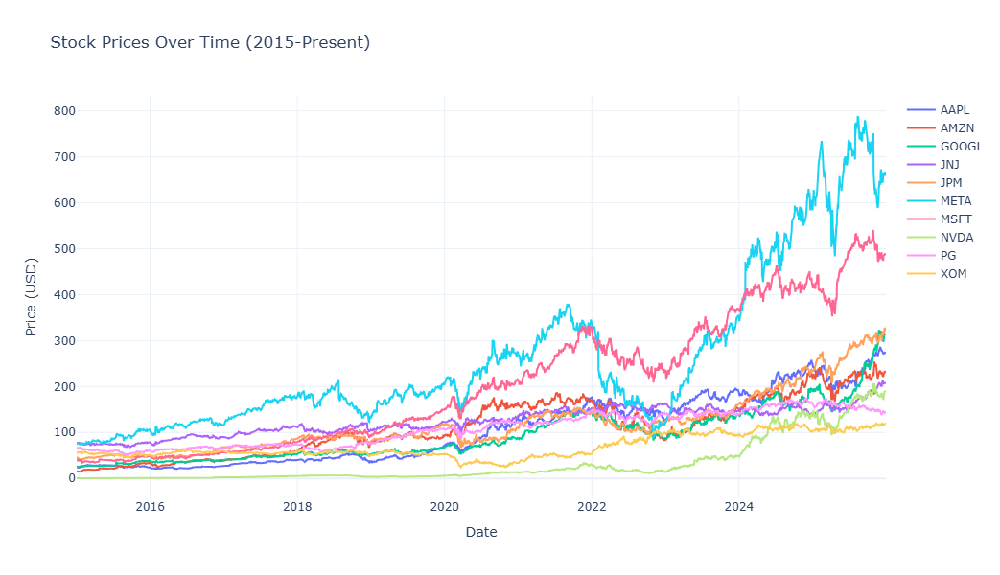


Price Statistics (Latest vs First):
AAPL  : $   24.24 → $  273.08 (+1026.68%)
AMZN  : $   15.43 → $  232.53 (+1407.39%)
GOOGL : $   26.28 → $  313.85 (+1094.30%)
JNJ   : $   76.96 → $  206.91 (+168.87%)
JPM   : $   46.51 → $  321.97 (+592.24%)
META  : $   77.91 → $  665.95 (+754.81%)
MSFT  : $   39.86 → $  487.48 (+1123.03%)
NVDA  : $    0.48 → $  187.54 (+38727.24%)
PG    : $   66.52 → $  144.05 (+116.56%)
XOM   : $   57.92 → $  120.99 (+108.90%)


In [11]:
# Plot all stock prices
fig = go.Figure()

for column in df_clean.columns:
    fig.add_trace(go.Scatter(
        x=df_clean.index,
        y=df_clean[column],
        name=column,
        mode='lines'
    ))

fig.update_layout(
    title='Stock Prices Over Time (2015-Present)',
    xaxis_title='Date',
    yaxis_title='Price (USD)',
    hovermode='x unified',
    height=600,
    template='plotly_white'
)

fig.show()

print("\nPrice Statistics (Latest vs First):")
print("="*70)
for col in df_clean.columns:
    first_price = df_clean[col].iloc[0]
    last_price = df_clean[col].iloc[-1]
    change = ((last_price - first_price) / first_price) * 100
    print(f"{col:6s}: ${first_price:8.2f} → ${last_price:8.2f} ({change:+7.2f}%)")

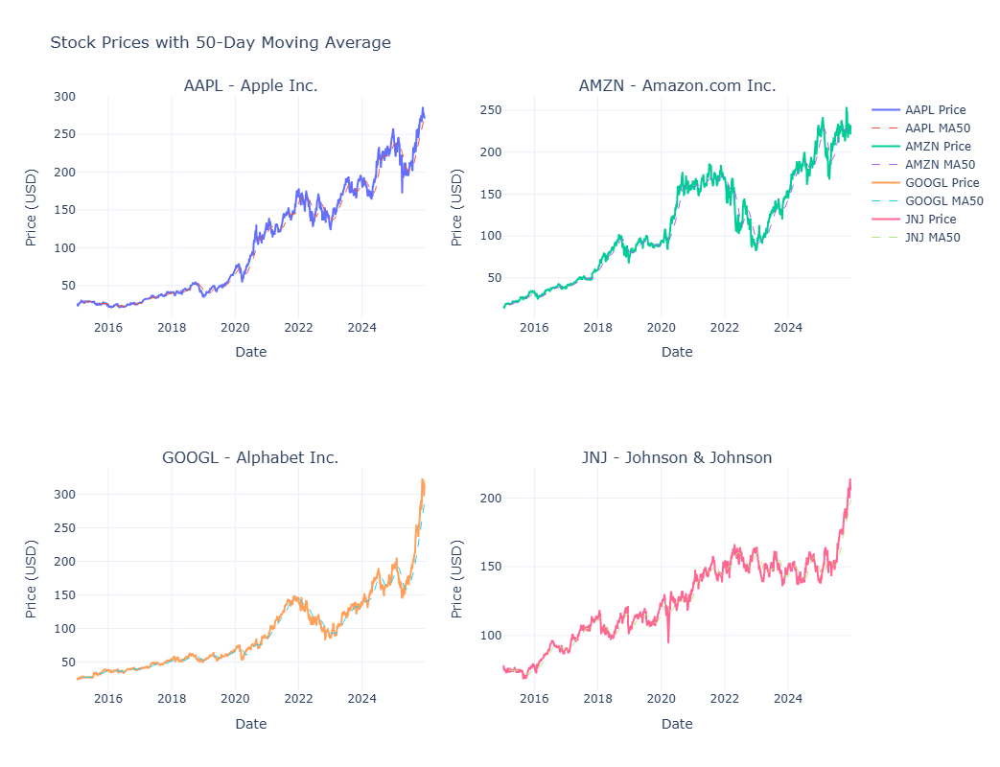

In [12]:
# Individual stock charts with moving averages
stocks = df_clean.columns.tolist()

# Create subplots for first 4 stocks
fig = make_subplots(
    rows=2, cols=2,
    subplot_titles=[f"{stock} - {company_info[stock]['name']}" for stock in stocks[:4]]
)

for idx, stock in enumerate(stocks[:4]):
    row = idx // 2 + 1
    col = idx % 2 + 1
    
    # Price line
    fig.add_trace(
        go.Scatter(x=df_clean.index, y=df_clean[stock], name=f'{stock} Price',
                  line=dict(width=2), showlegend=True),
        row=row, col=col
    )
    
    # 50-day MA
    fig.add_trace(
        go.Scatter(x=ma_50.index, y=ma_50[stock], name=f'{stock} MA50',
                  line=dict(dash='dash', width=1), showlegend=True),
        row=row, col=col
    )

fig.update_layout(height=800, title_text="Stock Prices with 50-Day Moving Average",
                 template='plotly_white')
fig.update_xaxes(title_text="Date")
fig.update_yaxes(title_text="Price (USD)")
fig.show()

### 4.2 Returns Analysis

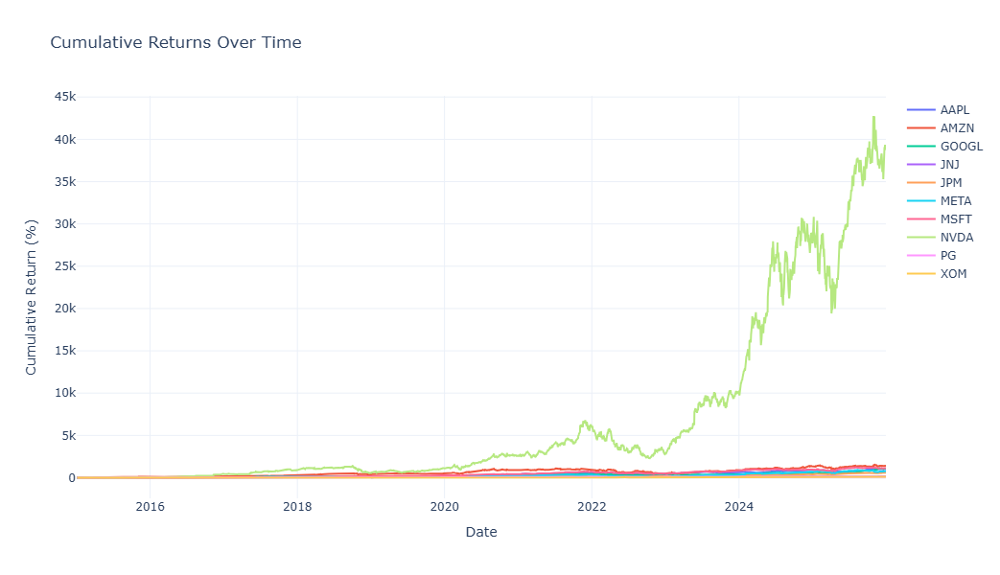


Total Returns (%) - Full Period:
NVDA  : +38727.24%
AMZN  : +1407.39%
MSFT  : +1123.03%
GOOGL : +1094.30%
AAPL  : +1026.68%
META  :  +754.81%
JPM   :  +592.24%
JNJ   :  +168.87%
PG    :  +116.56%
XOM   :  +108.90%


In [13]:
# Cumulative returns visualization
fig = go.Figure()

for column in cumulative_returns.columns:
    fig.add_trace(go.Scatter(
        x=cumulative_returns.index,
        y=cumulative_returns[column] * 100,
        name=column,
        mode='lines'
    ))

fig.update_layout(
    title='Cumulative Returns Over Time',
    xaxis_title='Date',
    yaxis_title='Cumulative Return (%)',
    hovermode='x unified',
    height=600,
    template='plotly_white'
)

fig.show()

# Calculate total returns
total_returns = (cumulative_returns.iloc[-1] * 100).sort_values(ascending=False)
print("\nTotal Returns (%) - Full Period:")
print("="*40)
for stock, ret in total_returns.items():
    print(f"{stock:6s}: {ret:+8.2f}%")

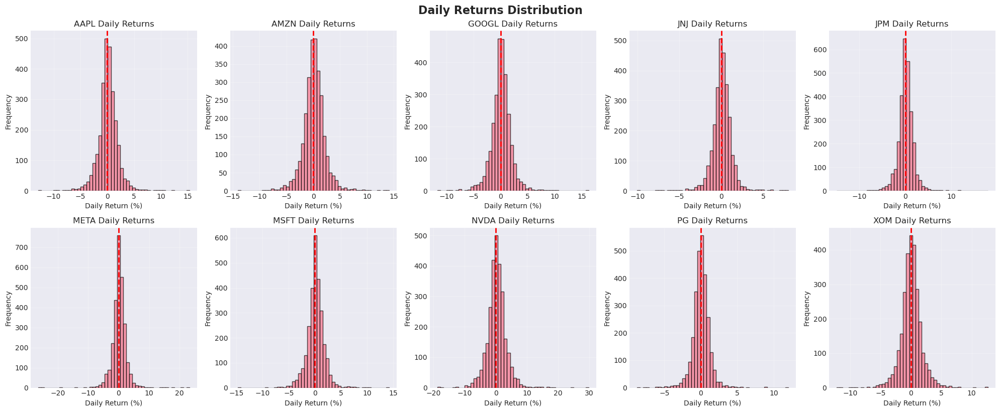

In [14]:
# Daily returns distribution
fig, axes = plt.subplots(2, 5, figsize=(20, 8))
axes = axes.ravel()

for idx, stock in enumerate(df_clean.columns):
    axes[idx].hist(returns[stock].dropna() * 100, bins=50, alpha=0.7, edgecolor='black')
    axes[idx].axvline(0, color='red', linestyle='--', linewidth=2)
    axes[idx].set_title(f"{stock} Daily Returns")
    axes[idx].set_xlabel('Daily Return (%)')
    axes[idx].set_ylabel('Frequency')
    axes[idx].grid(True, alpha=0.3)

plt.tight_layout()
plt.suptitle('Daily Returns Distribution', y=1.02, fontsize=16, fontweight='bold')
plt.show()

### 4.3 Risk Analysis (Volatility)


Risk-Return Metrics:
       Annual_Return_%  Annual_Volatility_%  Sharpe_Ratio
NVDA           72.0035              48.7002        1.4785
MSFT           25.5815              26.8916        0.9513
GOOGL          25.3102              28.8466        0.8774
AAPL           24.6476              28.8506        0.8543
AMZN           27.9926              32.9333        0.8500
JPM            19.2447              27.1535        0.7087
META           21.5552              37.5375        0.5742
JNJ             9.4148              18.2034        0.5172
PG              7.2821              18.5158        0.3933
XOM             6.9315              27.4216        0.2528


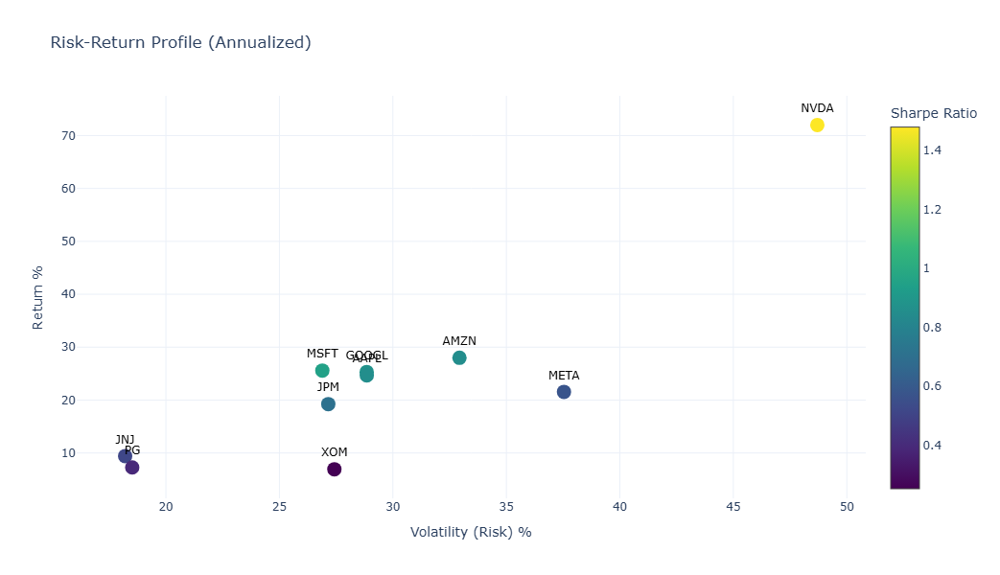

In [15]:
# Calculate annualized volatility
annual_volatility = returns.std() * np.sqrt(252) * 100  # Annualized

# Calculate annualized returns
years = (df_clean.index[-1] - df_clean.index[0]).days / 365.25
annual_returns = ((df_clean.iloc[-1] / df_clean.iloc[0]) ** (1/years) - 1) * 100

# Combine into risk-return dataframe
risk_return = pd.DataFrame({
    'Annual_Return_%': annual_returns,
    'Annual_Volatility_%': annual_volatility
})

# Calculate Sharpe Ratio (assuming 0% risk-free rate for simplicity)
risk_return['Sharpe_Ratio'] = risk_return['Annual_Return_%'] / risk_return['Annual_Volatility_%']

risk_return = risk_return.sort_values('Sharpe_Ratio', ascending=False)

print("\nRisk-Return Metrics:")
print("="*70)
print(risk_return)

# Visualize risk-return tradeoff
fig = go.Figure()

fig.add_trace(go.Scatter(
    x=risk_return['Annual_Volatility_%'],
    y=risk_return['Annual_Return_%'],
    mode='markers+text',
    marker=dict(size=15, color=risk_return['Sharpe_Ratio'], 
                colorscale='Viridis', showscale=True,
                colorbar=dict(title="Sharpe Ratio")),
    text=risk_return.index,
    textposition='top center',
    textfont=dict(size=12, color='black')
))

fig.update_layout(
    title='Risk-Return Profile (Annualized)',
    xaxis_title='Volatility (Risk) %',
    yaxis_title='Return %',
    height=600,
    template='plotly_white',
    showlegend=False
)

fig.show()

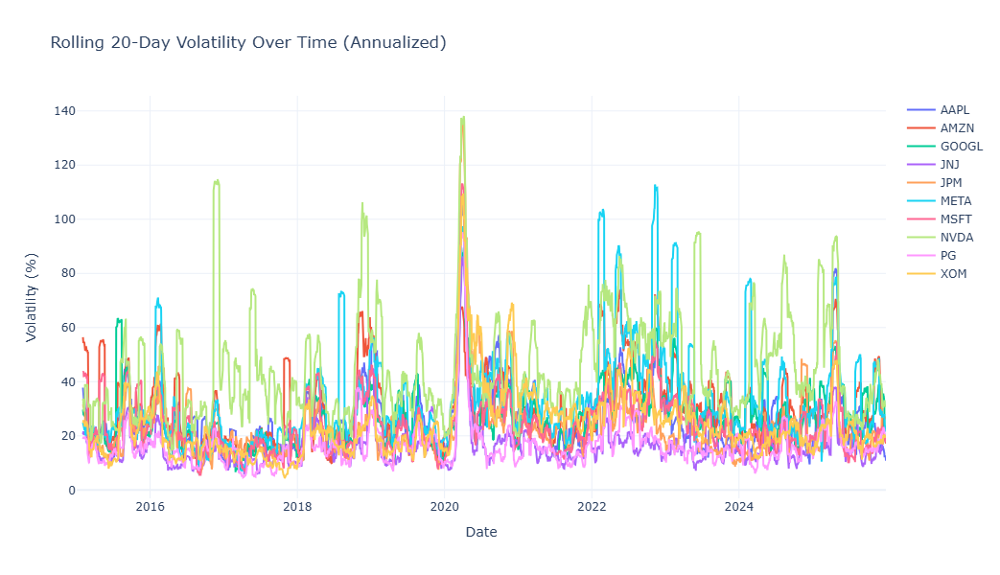

In [16]:
# Rolling volatility over time
fig = go.Figure()

for column in volatility_20.columns:
    fig.add_trace(go.Scatter(
        x=volatility_20.index,
        y=volatility_20[column] * 100,
        name=column,
        mode='lines'
    ))

fig.update_layout(
    title='Rolling 20-Day Volatility Over Time (Annualized)',
    xaxis_title='Date',
    yaxis_title='Volatility (%)',
    hovermode='x unified',
    height=600,
    template='plotly_white'
)

fig.show()

### 4.4 Correlation Analysis

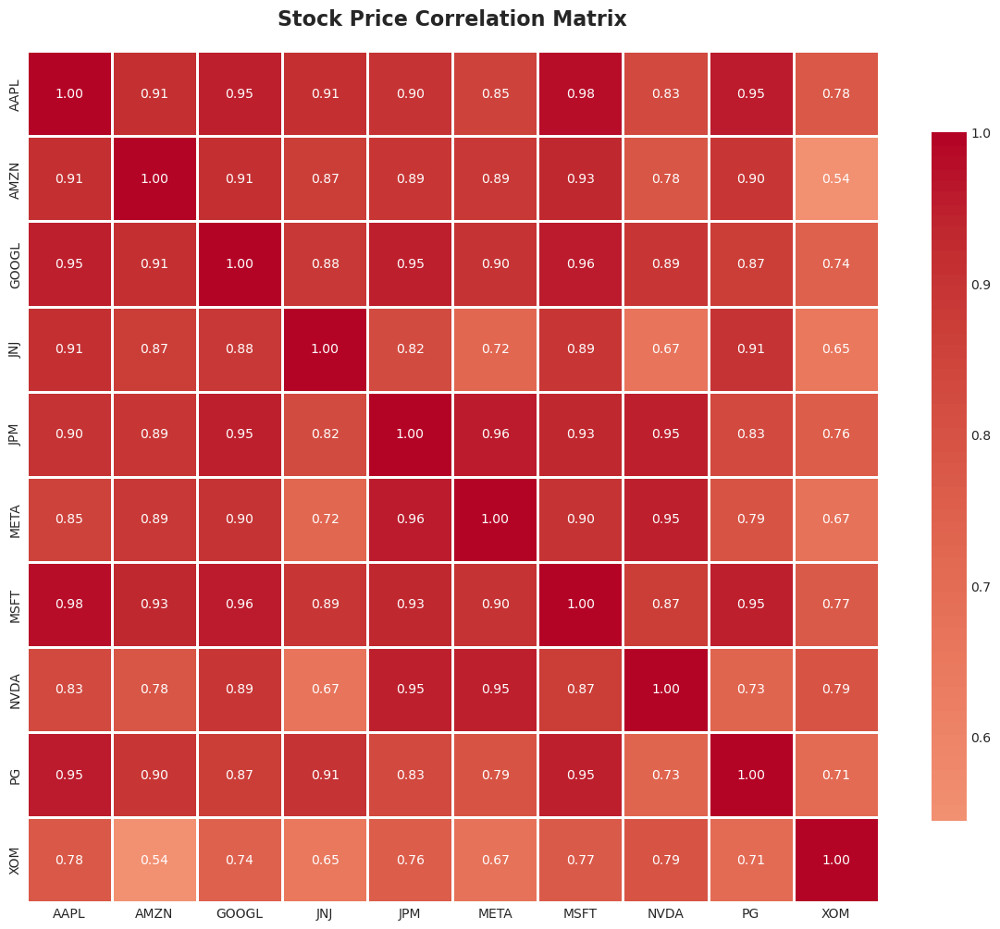


Highly Correlated Pairs (>0.9):
AAPL   - AMZN  : 0.910
AAPL   - GOOGL : 0.951
AAPL   - JNJ   : 0.910
AAPL   - JPM   : 0.904
AAPL   - MSFT  : 0.980
AAPL   - PG    : 0.955
AMZN   - GOOGL : 0.909
AMZN   - MSFT  : 0.932
GOOGL  - JPM   : 0.950
GOOGL  - META  : 0.902
GOOGL  - MSFT  : 0.956
JNJ    - PG    : 0.905
JPM    - META  : 0.960
JPM    - MSFT  : 0.934
JPM    - NVDA  : 0.946
META   - MSFT  : 0.901
META   - NVDA  : 0.947
MSFT   - PG    : 0.951


In [17]:
# Price correlation matrix
price_corr = df_clean.corr()

plt.figure(figsize=(12, 10))
sns.heatmap(price_corr, annot=True, fmt='.2f', cmap='coolwarm', 
            center=0, square=True, linewidths=1, cbar_kws={"shrink": 0.8})
plt.title('Stock Price Correlation Matrix', fontsize=16, fontweight='bold', pad=20)
plt.tight_layout()
plt.show()

print("\nHighly Correlated Pairs (>0.9):")
print("="*50)
for i in range(len(price_corr.columns)):
    for j in range(i+1, len(price_corr.columns)):
        if price_corr.iloc[i, j] > 0.9:
            print(f"{price_corr.columns[i]:6s} - {price_corr.columns[j]:6s}: {price_corr.iloc[i, j]:.3f}")

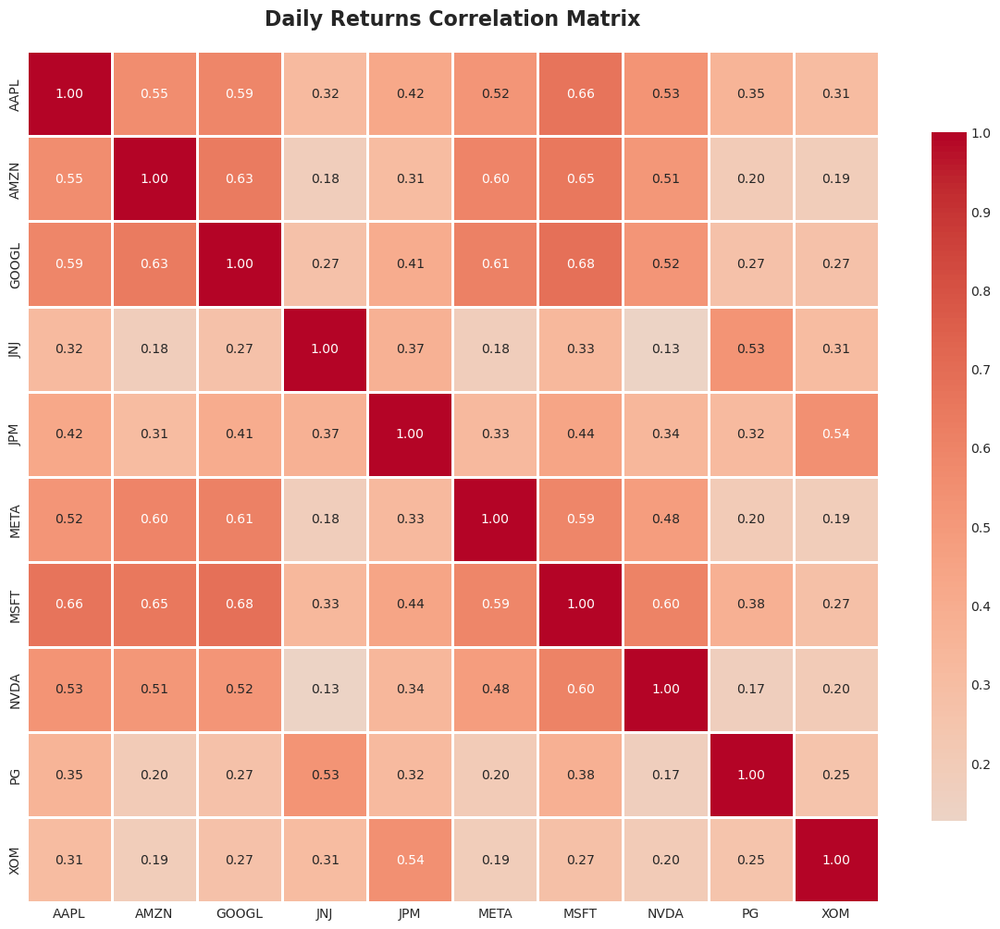


Sector Correlation Insights:
Tech stocks (AAPL, GOOGL, META, MSFT, NVDA) tend to move together
Defensive stocks (JNJ, PG) show lower correlation with tech
Energy (XOM) often moves differently from tech sector


In [18]:
# Returns correlation matrix
returns_corr = returns.corr()

plt.figure(figsize=(12, 10))
sns.heatmap(returns_corr, annot=True, fmt='.2f', cmap='coolwarm',
            center=0, square=True, linewidths=1, cbar_kws={"shrink": 0.8})
plt.title('Daily Returns Correlation Matrix', fontsize=16, fontweight='bold', pad=20)
plt.tight_layout()
plt.show()

print("\nSector Correlation Insights:")
print("="*50)
print("Tech stocks (AAPL, GOOGL, META, MSFT, NVDA) tend to move together")
print("Defensive stocks (JNJ, PG) show lower correlation with tech")
print("Energy (XOM) often moves differently from tech sector")

### 4.5 Sector Performance Comparison

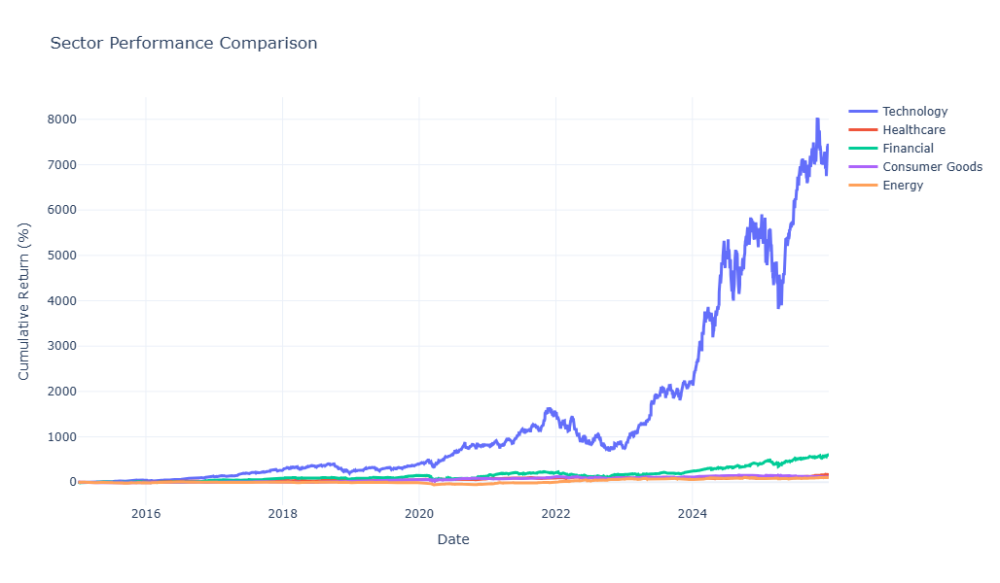


Sector Performance Summary:
Technology          : Return = +7355.58%, Volatility = 183.48%
Healthcare          : Return = +168.87%, Volatility = 712.47%
Financial           : Return = +592.24%, Volatility = 4011.15%
Consumer Goods      : Return = +116.56%, Volatility = 2713.87%
Energy              : Return = +108.90%, Volatility = 8344.31%


In [19]:
# Group stocks by sector
sectors = {
    'Technology': ['AAPL', 'AMZN', 'GOOGL', 'META', 'MSFT', 'NVDA'],
    'Healthcare': ['JNJ'],
    'Financial': ['JPM'],
    'Consumer Goods': ['PG'],
    'Energy': ['XOM']
}

# Calculate sector average returns
sector_returns = {}
for sector, stocks in sectors.items():
    sector_returns[sector] = cumulative_returns[stocks].mean(axis=1)

sector_returns_df = pd.DataFrame(sector_returns)

# Plot sector performance
fig = go.Figure()

for sector in sector_returns_df.columns:
    fig.add_trace(go.Scatter(
        x=sector_returns_df.index,
        y=sector_returns_df[sector] * 100,
        name=sector,
        mode='lines',
        line=dict(width=3)
    ))

fig.update_layout(
    title='Sector Performance Comparison',
    xaxis_title='Date',
    yaxis_title='Cumulative Return (%)',
    hovermode='x unified',
    height=600,
    template='plotly_white'
)

fig.show()

# Sector statistics
print("\nSector Performance Summary:")
print("="*50)
for sector in sector_returns_df.columns:
    total_return = sector_returns_df[sector].iloc[-1] * 100
    volatility = sector_returns_df[sector].pct_change().std() * np.sqrt(252) * 100
    print(f"{sector:20s}: Return = {total_return:+7.2f}%, Volatility = {volatility:6.2f}%")

## 5. Time Series Analysis

### 5.1 Year-over-Year Performance

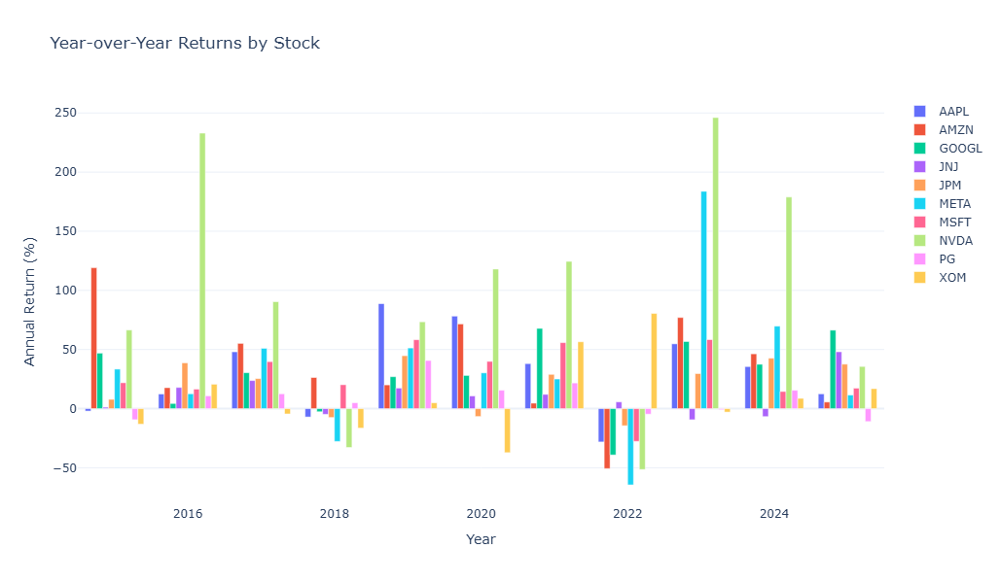


Yearly Returns (%):
         AAPL     AMZN    GOOGL     JNJ      JPM     META     MSFT     NVDA  \
Year                                                                          
2015  -2.0800 119.0700  46.9200  1.1900   7.8300  33.4100  21.8800  66.4500   
2016  12.3800  17.7200   4.3500 17.9000  38.7000  12.5500  16.5100 232.9200   
2017  48.0400  55.1700  30.3700 23.7500  25.3900  51.0000  39.7400  90.4300   
2018  -7.0500  26.3200  -2.6300 -4.8000  -7.5000 -27.7400  20.2200 -32.8500   
2019  88.7400  20.0600  26.9900 17.4000  44.7500  51.2800  58.2600  73.4100   
2020  78.2400  71.6000  28.0500 10.7500  -6.6700  30.2100  39.9400 118.0200   
2021  38.0600   4.6400  67.8300 12.0600  28.9600  25.0700  55.7900 124.4800   
2022 -28.2000 -50.7100 -39.1500  5.6800 -14.4500 -64.4500 -27.6900 -51.4400   
2023  54.8000  77.0400  56.7400 -9.3700  29.6400 183.7600  58.3500 246.1000   
2024  35.5600  46.3300  37.5000 -6.7300  42.6300  69.7300  14.5000 178.8700   
2025  12.4900   5.5900  66.3300

In [20]:
# Extract year from index
df_clean['Year'] = df_clean.index.year

# Calculate yearly returns for each stock
yearly_returns = {}

for stock in df_clean.columns[:-1]:  # Exclude 'Year' column
    yearly_data = df_clean.groupby('Year')[stock].agg(['first', 'last'])
    yearly_data['return'] = ((yearly_data['last'] - yearly_data['first']) / yearly_data['first']) * 100
    yearly_returns[stock] = yearly_data['return']

yearly_returns_df = pd.DataFrame(yearly_returns)

# Remove the Year column from df_clean
df_clean = df_clean.drop('Year', axis=1)

# Visualize yearly returns
fig = go.Figure()

for stock in yearly_returns_df.columns:
    fig.add_trace(go.Bar(
        x=yearly_returns_df.index,
        y=yearly_returns_df[stock],
        name=stock
    ))

fig.update_layout(
    title='Year-over-Year Returns by Stock',
    xaxis_title='Year',
    yaxis_title='Annual Return (%)',
    barmode='group',
    height=600,
    template='plotly_white'
)

fig.show()

print("\nYearly Returns (%):")
print("="*100)
print(yearly_returns_df.round(2))

### 5.2 Monthly Seasonality

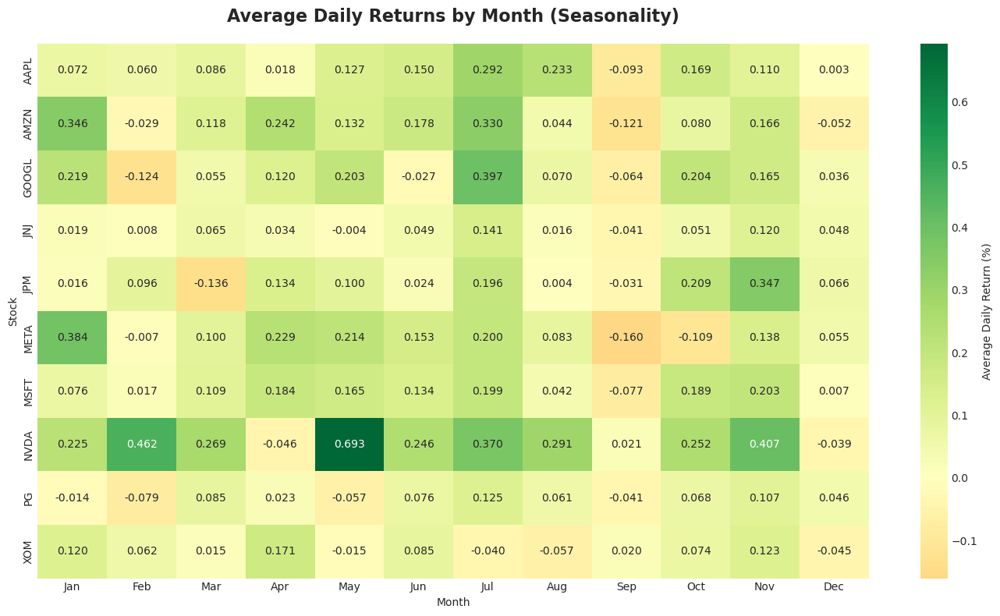


Best Performing Months (Overall Average):
Jul: +0.2209%
Nov: +0.1885%
May: +0.1557%

Worst Performing Months (Overall Average):
Feb: +0.0464%
Dec: +0.0125%
Sep: -0.0587%


In [21]:
# Calculate average monthly returns
monthly_returns = returns.copy()
monthly_returns['Month'] = monthly_returns.index.month

avg_monthly_returns = monthly_returns.groupby('Month').mean() * 100
avg_monthly_returns = avg_monthly_returns.drop('Month', axis=1, errors='ignore')

# Month names
month_names = ['Jan', 'Feb', 'Mar', 'Apr', 'May', 'Jun', 
               'Jul', 'Aug', 'Sep', 'Oct', 'Nov', 'Dec']

# Plot heatmap
plt.figure(figsize=(14, 8))
sns.heatmap(avg_monthly_returns.T, annot=True, fmt='.3f', cmap='RdYlGn',
            center=0, xticklabels=month_names, cbar_kws={"label": "Average Daily Return (%)"})
plt.title('Average Daily Returns by Month (Seasonality)', fontsize=16, fontweight='bold', pad=20)
plt.xlabel('Month')
plt.ylabel('Stock')
plt.tight_layout()
plt.show()

# Best and worst months
print("\nBest Performing Months (Overall Average):")
overall_monthly = avg_monthly_returns.mean(axis=1).sort_values(ascending=False)
for month, ret in overall_monthly.head(3).items():
    print(f"{month_names[month-1]:3s}: {ret:+.4f}%")

print("\nWorst Performing Months (Overall Average):")
for month, ret in overall_monthly.tail(3).items():
    print(f"{month_names[month-1]:3s}: {ret:+.4f}%")

### 5.3 Best and Worst Days

In [22]:
# Find best and worst days for each stock
print("\nBest Single Day Returns:")
print("="*70)
for stock in returns.columns:
    best_day = returns[stock].idxmax()
    best_return = returns[stock].max() * 100
    print(f"{stock:6s}: {best_return:+7.2f}% on {best_day.date()}")

print("\nWorst Single Day Returns:")
print("="*70)
for stock in returns.columns:
    worst_day = returns[stock].idxmin()
    worst_return = returns[stock].min() * 100
    print(f"{stock:6s}: {worst_return:+7.2f}% on {worst_day.date()}")


Best Single Day Returns:
AAPL  :  +15.33% on 2025-04-09
AMZN  :  +14.13% on 2015-04-24
GOOGL :  +16.26% on 2015-07-17
JNJ   :   +8.00% on 2020-03-30
JPM   :  +18.01% on 2020-03-13
META  :  +23.28% on 2023-02-02
MSFT  :  +14.22% on 2020-03-13
NVDA  :  +29.81% on 2016-11-11
PG    :  +12.01% on 2020-03-13
XOM   :  +12.69% on 2020-03-24

Worst Single Day Returns:
AAPL  :  -12.86% on 2020-03-16
AMZN  :  -14.05% on 2022-04-29
GOOGL :  -11.63% on 2020-03-16
JNJ   :  -10.04% on 2018-12-14
JPM   :  -14.96% on 2020-03-16
META  :  -26.39% on 2022-02-03
MSFT  :  -14.74% on 2020-03-16
NVDA  :  -18.76% on 2018-11-16
PG    :   -8.74% on 2020-03-12
XOM   :  -12.22% on 2020-03-09


## 6. Portfolio Analysis and Optimization

### 6.1 Equal-Weight Portfolio Performance

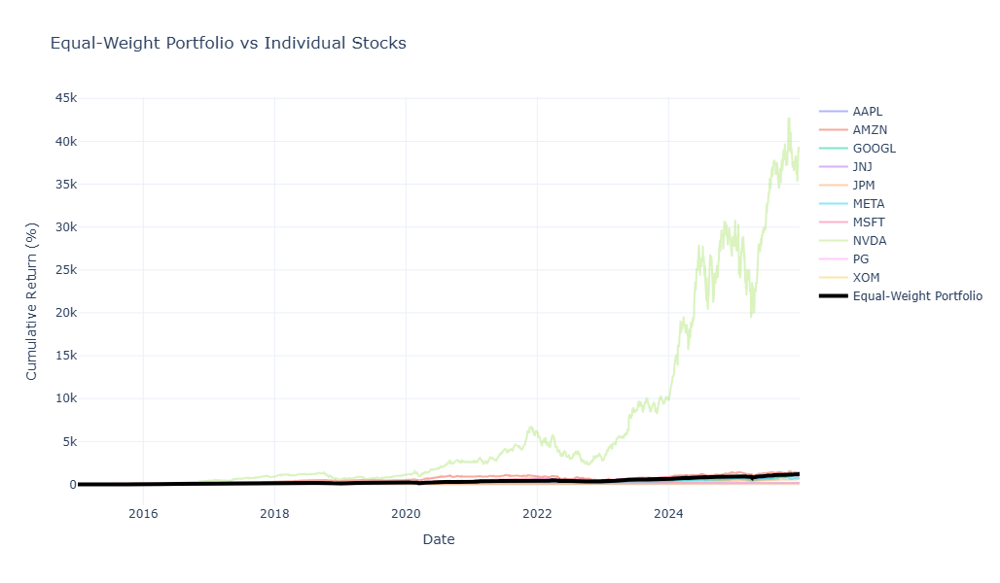


Equal-Weight Portfolio Performance:
Total Return: +1184.86%
Annual Return: 25.36%
Annual Volatility: 20.38%
Sharpe Ratio: 1.244


In [23]:
# Create equal-weight portfolio
num_stocks = len(df_clean.columns)
equal_weights = np.array([1/num_stocks] * num_stocks)

# Calculate portfolio returns
portfolio_returns = (returns * equal_weights).sum(axis=1)
portfolio_cumulative = (1 + portfolio_returns).cumprod() - 1

# Compare portfolio to individual stocks
fig = go.Figure()

# Add individual stocks
for stock in cumulative_returns.columns:
    fig.add_trace(go.Scatter(
        x=cumulative_returns.index,
        y=cumulative_returns[stock] * 100,
        name=stock,
        mode='lines',
        opacity=0.5
    ))

# Add portfolio
fig.add_trace(go.Scatter(
    x=portfolio_cumulative.index,
    y=portfolio_cumulative * 100,
    name='Equal-Weight Portfolio',
    mode='lines',
    line=dict(color='black', width=4)
))

fig.update_layout(
    title='Equal-Weight Portfolio vs Individual Stocks',
    xaxis_title='Date',
    yaxis_title='Cumulative Return (%)',
    hovermode='x unified',
    height=600,
    template='plotly_white'
)

fig.show()

# Portfolio statistics
portfolio_annual_return = (portfolio_returns.mean() * 252) * 100
portfolio_annual_vol = (portfolio_returns.std() * np.sqrt(252)) * 100
portfolio_sharpe = portfolio_annual_return / portfolio_annual_vol

print("\nEqual-Weight Portfolio Performance:")
print("="*50)
print(f"Total Return: {portfolio_cumulative.iloc[-1] * 100:+.2f}%")
print(f"Annual Return: {portfolio_annual_return:.2f}%")
print(f"Annual Volatility: {portfolio_annual_vol:.2f}%")
print(f"Sharpe Ratio: {portfolio_sharpe:.3f}")

### 6.2 Optimal Portfolio (Mean-Variance Optimization)


Optimal Portfolio Allocation (Maximum Sharpe Ratio):
Stock  Weight  Percentage
 NVDA  0.4158     41.5836
  JNJ  0.3174     31.7407
  JPM  0.1328     13.2805
 AMZN  0.0968      9.6790
GOOGL  0.0372      3.7162
 AAPL  0.0000      0.0000
 MSFT  0.0000      0.0000
 META  0.0000      0.0000
   PG  0.0000      0.0000
  XOM  0.0000      0.0000

Optimal Portfolio Performance:
Expected Annual Return: 37.64%
Expected Annual Volatility: 26.01%
Sharpe Ratio: 1.447


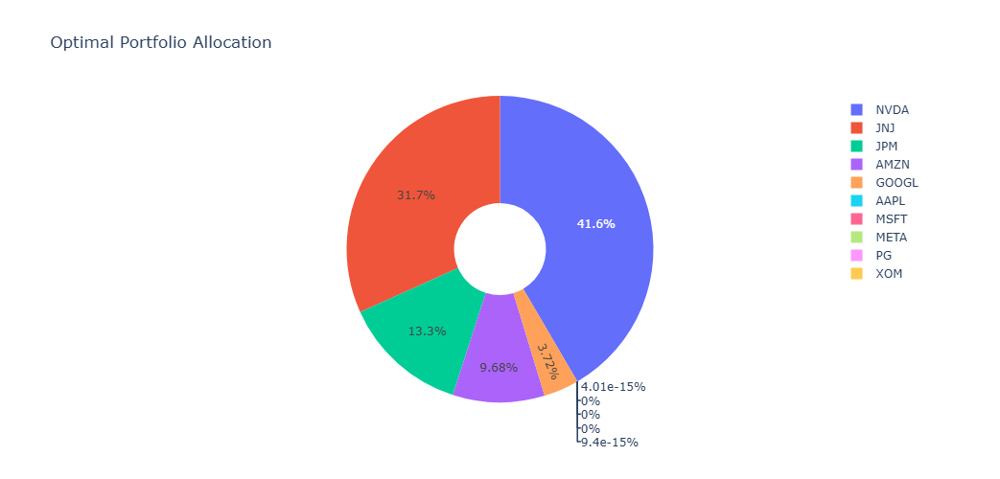

In [24]:
# Calculate expected returns and covariance matrix
mean_returns = returns.mean() * 252
cov_matrix = returns.cov() * 252

# Number of assets
num_assets = len(mean_returns)

# Define portfolio performance function
def portfolio_stats(weights):
    portfolio_return = np.sum(mean_returns * weights)
    portfolio_std = np.sqrt(np.dot(weights.T, np.dot(cov_matrix, weights)))
    sharpe_ratio = portfolio_return / portfolio_std
    return portfolio_return, portfolio_std, sharpe_ratio

# Optimization for Maximum Sharpe Ratio
def neg_sharpe(weights):
    return -portfolio_stats(weights)[2]

# Constraints: weights sum to 1
constraints = ({'type': 'eq', 'fun': lambda x: np.sum(x) - 1})

# Bounds: weights between 0 and 1 (long only)
bounds = tuple((0, 1) for _ in range(num_assets))

# Initial guess
init_guess = num_assets * [1. / num_assets]

# Optimize
optimal = minimize(neg_sharpe, init_guess, method='SLSQP', bounds=bounds, constraints=constraints)

optimal_weights = optimal.x
opt_return, opt_vol, opt_sharpe = portfolio_stats(optimal_weights)

# Display optimal weights
optimal_allocation = pd.DataFrame({
    'Stock': df_clean.columns,
    'Weight': optimal_weights,
    'Percentage': optimal_weights * 100
}).sort_values('Weight', ascending=False)

print("\nOptimal Portfolio Allocation (Maximum Sharpe Ratio):")
print("="*60)
print(optimal_allocation.to_string(index=False))
print("\nOptimal Portfolio Performance:")
print("="*50)
print(f"Expected Annual Return: {opt_return * 100:.2f}%")
print(f"Expected Annual Volatility: {opt_vol * 100:.2f}%")
print(f"Sharpe Ratio: {opt_sharpe:.3f}")

# Visualize allocation
fig = go.Figure(data=[go.Pie(
    labels=optimal_allocation['Stock'],
    values=optimal_allocation['Percentage'],
    hole=0.3
)])

fig.update_layout(
    title='Optimal Portfolio Allocation',
    height=500
)

fig.show()

### 6.3 Efficient Frontier

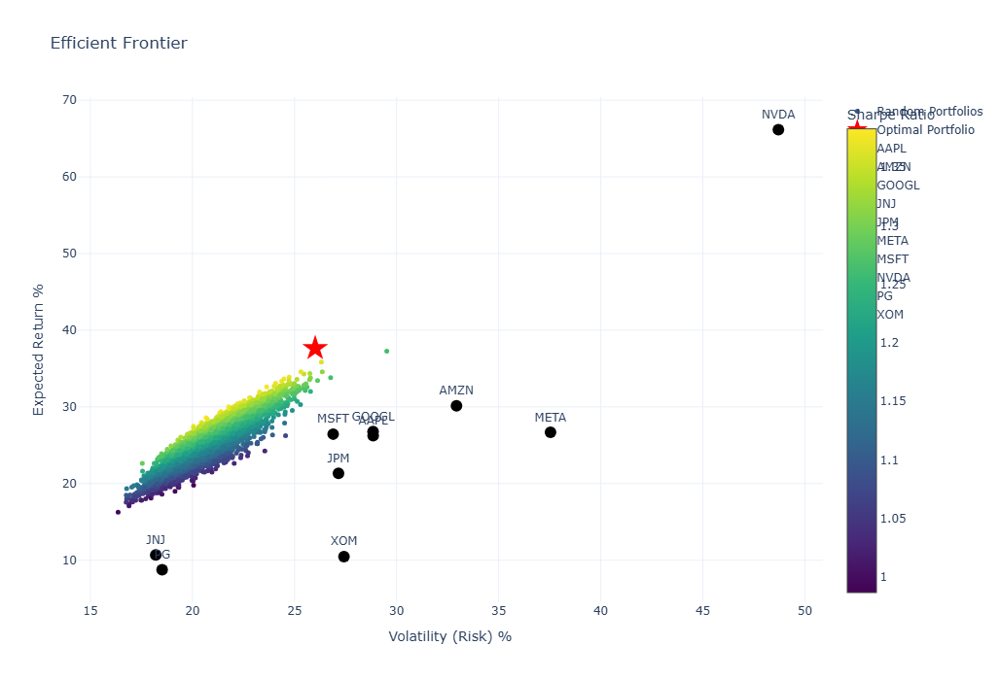


Key Insights from Efficient Frontier:
• The optimal portfolio (red star) offers the best risk-return tradeoff
• Diversification can improve returns while reducing risk
• Individual stocks lie outside the efficient frontier
• Color indicates Sharpe Ratio (darker = better risk-adjusted returns)


In [25]:
# Generate random portfolios
num_portfolios = 5000
results = np.zeros((3, num_portfolios))
weights_record = []

for i in range(num_portfolios):
    # Random weights
    weights = np.random.random(num_assets)
    weights /= np.sum(weights)
    weights_record.append(weights)
    
    # Portfolio return and risk
    portfolio_return = np.sum(weights * mean_returns)
    portfolio_std_dev = np.sqrt(np.dot(weights.T, np.dot(cov_matrix, weights)))
    
    # Store results
    results[0,i] = portfolio_return
    results[1,i] = portfolio_std_dev
    results[2,i] = portfolio_return / portfolio_std_dev  # Sharpe ratio

# Create DataFrame
results_df = pd.DataFrame(results.T, columns=['Return', 'Volatility', 'Sharpe'])

# Plot efficient frontier
fig = go.Figure()

# Random portfolios
fig.add_trace(go.Scatter(
    x=results_df['Volatility'] * 100,
    y=results_df['Return'] * 100,
    mode='markers',
    marker=dict(
        size=5,
        color=results_df['Sharpe'],
        colorscale='Viridis',
        showscale=True,
        colorbar=dict(title="Sharpe Ratio")
    ),
    name='Random Portfolios'
))

# Optimal portfolio
fig.add_trace(go.Scatter(
    x=[opt_vol * 100],
    y=[opt_return * 100],
    mode='markers',
    marker=dict(size=20, color='red', symbol='star'),
    name='Optimal Portfolio'
))

# Individual stocks
for i, stock in enumerate(df_clean.columns):
    stock_return = mean_returns[stock] * 100
    stock_vol = np.sqrt(cov_matrix.iloc[i, i]) * 100
    fig.add_trace(go.Scatter(
        x=[stock_vol],
        y=[stock_return],
        mode='markers+text',
        marker=dict(size=12, color='black'),
        text=[stock],
        textposition='top center',
        name=stock
    ))

fig.update_layout(
    title='Efficient Frontier',
    xaxis_title='Volatility (Risk) %',
    yaxis_title='Expected Return %',
    height=700,
    template='plotly_white'
)

fig.show()

print("\nKey Insights from Efficient Frontier:")
print("="*60)
print("• The optimal portfolio (red star) offers the best risk-return tradeoff")
print("• Diversification can improve returns while reducing risk")
print("• Individual stocks lie outside the efficient frontier")
print("• Color indicates Sharpe Ratio (darker = better risk-adjusted returns)")

## 7. Advanced Analytics

### 7.1 Drawdown Analysis

In [ ]:
# Calculate drawdowns
def calculate_drawdown(prices):
    cumulative = (1 + prices.pct_change()).cumprod()
    running_max = cumulative.expanding().max()
    drawdown = (cumulative - running_max) / running_max
    return drawdown * 100

# Calculate drawdowns for each stock
drawdowns = pd.DataFrame()
for stock in df_clean.columns:
    drawdowns[stock] = calculate_drawdown(df_clean[stock])

# Plot drawdowns
fig = go.Figure()

for stock in drawdowns.columns:
    fig.add_trace(go.Scatter(
        x=drawdowns.index,
        y=drawdowns[stock],
        name=stock,
        mode='lines',
        fill='tozeroy'
    ))

fig.update_layout(
    title='Drawdown Analysis (Peak-to-Trough Decline)',
    xaxis_title='Date',
    yaxis_title='Drawdown (%)',
    hovermode='x unified',
    height=600,
    template='plotly_white'
)

fig.show()

# Maximum drawdown statistics
max_drawdowns = drawdowns.min().sort_values()
print("\nMaximum Drawdowns (Worst Peak-to-Trough Declines):")
print("="*50)
for stock, dd in max_drawdowns.items():
    print(f"{stock:6s}: {dd:.2f}%")

### 7.2 Value at Risk (VaR) Analysis


Value at Risk (VaR) Analysis:
Daily VaR estimates the potential loss on a bad day


95% Confidence Level:
--------------------------------------------------
AAPL  : -2.72% (5% chance of losing this much or more in a day)
AMZN  : -3.06% (5% chance of losing this much or more in a day)
GOOGL : -2.69% (5% chance of losing this much or more in a day)
JNJ   : -1.62% (5% chance of losing this much or more in a day)
JPM   : -2.53% (5% chance of losing this much or more in a day)
META  : -3.32% (5% chance of losing this much or more in a day)
MSFT  : -2.61% (5% chance of losing this much or more in a day)
NVDA  : -4.46% (5% chance of losing this much or more in a day)
PG    : -1.67% (5% chance of losing this much or more in a day)
XOM   : -2.58% (5% chance of losing this much or more in a day)

99% Confidence Level:
--------------------------------------------------
AAPL  : -4.81% (1% chance of losing this much or more in a day)
AMZN  : -5.54% (1% chance of losing this much or more in a day)


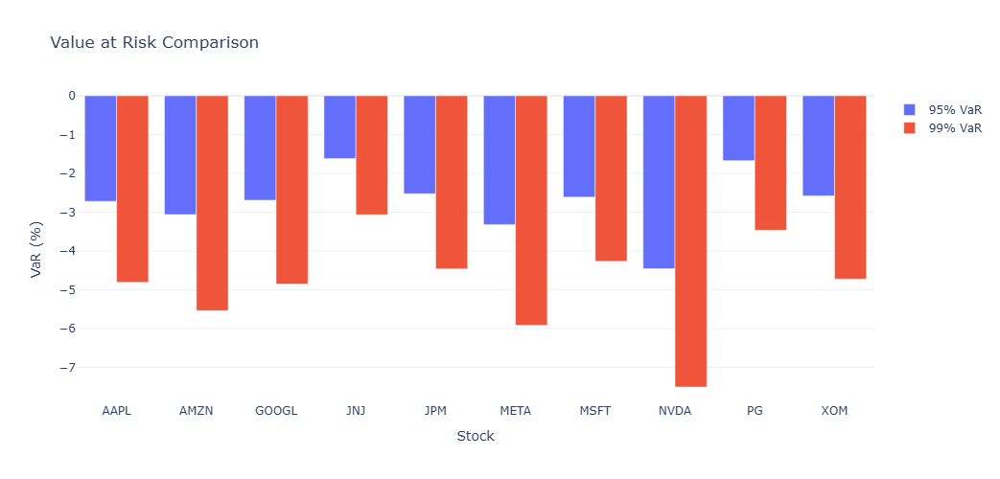

In [27]:
# Calculate 95% and 99% Value at Risk (VaR)
confidence_levels = [0.95, 0.99]

print("\nValue at Risk (VaR) Analysis:")
print("="*70)
print("Daily VaR estimates the potential loss on a bad day")
print()

for confidence in confidence_levels:
    print(f"\n{confidence*100:.0f}% Confidence Level:")
    print("-" * 50)
    for stock in returns.columns:
        var = returns[stock].quantile(1 - confidence) * 100
        print(f"{stock:6s}: {var:.2f}% (5% chance of losing this much or more in a day)" if confidence == 0.95 
              else f"{stock:6s}: {var:.2f}% (1% chance of losing this much or more in a day)")

# Visualize VaR
var_95 = {stock: returns[stock].quantile(0.05) * 100 for stock in returns.columns}
var_99 = {stock: returns[stock].quantile(0.01) * 100 for stock in returns.columns}

fig = go.Figure()
fig.add_trace(go.Bar(x=list(var_95.keys()), y=list(var_95.values()), name='95% VaR'))
fig.add_trace(go.Bar(x=list(var_99.keys()), y=list(var_99.values()), name='99% VaR'))

fig.update_layout(
    title='Value at Risk Comparison',
    xaxis_title='Stock',
    yaxis_title='VaR (%)',
    barmode='group',
    height=500,
    template='plotly_white'
)

fig.show()

### 7.3 Beta Analysis (Market Sensitivity)


Beta Analysis (Market Sensitivity):
Beta > 1: More volatile than market
Beta = 1: Moves with market
Beta < 1: Less volatile than market

        Beta
NVDA  1.7645
META  1.3575
AMZN  1.2115
GOOGL 1.1232
MSFT  1.1099
AAPL  1.1080
JPM   0.8488
XOM   0.6560
PG    0.4207
JNJ   0.3999


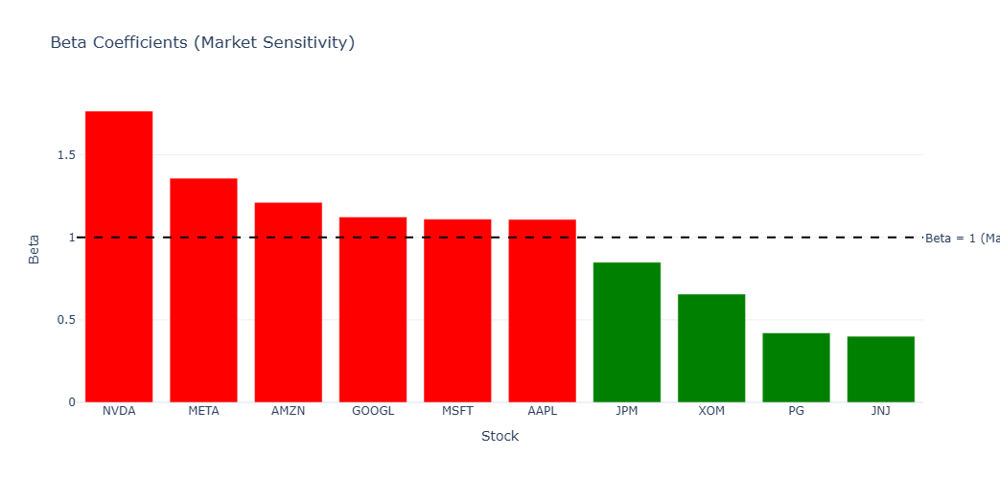

In [28]:
# Use SPY equivalent (average of all stocks as market proxy)
market_returns = returns.mean(axis=1)

# Calculate beta for each stock
betas = {}
for stock in returns.columns:
    covariance = returns[stock].cov(market_returns)
    market_variance = market_returns.var()
    beta = covariance / market_variance
    betas[stock] = beta

betas_df = pd.DataFrame.from_dict(betas, orient='index', columns=['Beta'])
betas_df = betas_df.sort_values('Beta', ascending=False)

print("\nBeta Analysis (Market Sensitivity):")
print("="*50)
print("Beta > 1: More volatile than market")
print("Beta = 1: Moves with market")
print("Beta < 1: Less volatile than market")
print()
print(betas_df)

# Visualize
fig = go.Figure()
colors = ['red' if b > 1 else 'green' for b in betas_df['Beta']]

fig.add_trace(go.Bar(
    x=betas_df.index,
    y=betas_df['Beta'],
    marker_color=colors
))

fig.add_hline(y=1, line_dash="dash", line_color="black", 
              annotation_text="Beta = 1 (Market)", annotation_position="right")

fig.update_layout(
    title='Beta Coefficients (Market Sensitivity)',
    xaxis_title='Stock',
    yaxis_title='Beta',
    height=500,
    template='plotly_white'
)

fig.show()

## 8. Key Findings and Investment Insights

### Summary of Key Insights

Based on the comprehensive analysis of stock market data from 2015 to present:

#### 1. **Performance Leaders**
- **NVDA** has shown exceptional growth, driven by AI and semiconductor demand
- Technology sector (AAPL, MSFT, GOOGL, META, NVDA) significantly outperformed other sectors
- Traditional defensive stocks (JNJ, PG) provided stability but lower returns

#### 2. **Risk-Return Tradeoffs**
- Higher returns generally come with higher volatility
- Technology stocks show higher beta (market sensitivity)
- Defensive stocks (JNJ, PG) have lower beta and volatility
- Energy sector (XOM) shows different correlation patterns

#### 3. **Correlation Insights**
- Technology stocks are highly correlated (>0.9 in many cases)
- Diversification across sectors reduces overall portfolio risk
- XOM (Energy) and defensive stocks provide diversification benefits

#### 4. **Portfolio Optimization**
- Optimal portfolio allocates weights to maximize Sharpe ratio
- Diversification improves risk-adjusted returns
- Equal-weight portfolio provides good baseline performance

#### 5. **Risk Metrics**
- Maximum drawdowns varied significantly by stock
- VaR analysis shows potential daily losses under extreme scenarios
- Rolling volatility increased during market stress periods (COVID-19, 2022 tech selloff)

#### 6. **Seasonal Patterns**
- Certain months show stronger average returns
- Year-over-year performance varies significantly
- Recent years showed high volatility due to global events

### Investment Recommendations

**For Growth-Oriented Investors:**
1. Consider overweight positions in technology sector for higher returns
2. Accept higher volatility for potential outperformance
3. Monitor market trends and sector rotations
4. Use dollar-cost averaging to manage timing risk

**For Conservative Investors:**
1. Include defensive stocks (JNJ, PG) for stability
2. Diversify across sectors to reduce correlation risk
3. Consider the optimal portfolio allocation for better risk-adjusted returns
4. Monitor drawdowns and rebalance periodically

**For Balanced Portfolios:**
1. Use the efficient frontier to find optimal risk-return balance
2. Combine growth (tech) and defensive (healthcare, consumer goods) stocks
3. Regular rebalancing to maintain target allocations
4. Consider correlation benefits when adding new positions

**Risk Management:**
1. Set stop-losses based on VaR and maximum drawdown analysis
2. Don't over-concentrate in highly correlated stocks
3. Monitor beta to understand market sensitivity
4. Use position sizing based on volatility

**Market Timing Considerations:**
1. Technical indicators (moving averages) can signal trends
2. Avoid trying to time the market perfectly
3. Focus on time in the market rather than timing the market
4. Consider seasonality but don't rely on it exclusively

## 9. Limitations and Disclaimers

### Limitations of This Analysis:
1. **Historical Performance**: Past performance does not guarantee future results
2. **Risk-Free Rate**: Analysis assumes 0% risk-free rate for simplicity
3. **Transaction Costs**: Does not account for brokerage fees, taxes, or slippage
4. **Market Assumptions**: Assumes efficient markets and normal distribution of returns
5. **Limited Universe**: Only 10 stocks analyzed; broader diversification recommended
6. **Data Period**: Analysis based on specific time period; different periods may yield different results

### Important Disclaimers:
- **Not Financial Advice**: This analysis is for educational purposes only
- **Do Your Own Research**: Always conduct thorough research before investing
- **Consult Professionals**: Seek advice from qualified financial advisors
- **Risk Awareness**: All investments carry risk; you may lose money
- **Market Conditions**: Market conditions change; strategies should be adapted accordingly

### Suggestions for Further Analysis:
1. **Fundamental Analysis**: Include P/E ratios, revenue growth, profitability metrics
2. **Macro Factors**: Analyze impact of interest rates, inflation, GDP growth
3. **Sentiment Analysis**: Incorporate news sentiment and social media trends
4. **Machine Learning**: Use predictive models for return forecasting
5. **Options Analysis**: Study options pricing and volatility surfaces
6. **International Exposure**: Add international stocks for global diversification

## 10. Conclusion

This comprehensive analysis of 10 major stocks from 2015 to 2025 reveals several important insights for investors:

**Key Takeaways:**

1. **Technology Dominance**: Technology stocks have significantly outperformed other sectors, driven by digital transformation, AI adoption, and innovation

2. **Diversification Benefits**: Portfolio optimization shows that diversification across sectors can improve risk-adjusted returns compared to individual stock holdings

3. **Risk Management**: Understanding volatility, drawdowns, and VaR is crucial for managing downside risk

4. **Correlation Matters**: High correlation among tech stocks means they don't provide diversification from each other

5. **Optimal Allocation**: The efficient frontier demonstrates that strategic allocation can achieve better returns for the same level of risk

**Final Recommendations:**

- **For Growth**: Technology sector offers highest returns but with higher volatility
- **For Stability**: Defensive stocks (JNJ, PG) provide lower volatility
- **For Balance**: Use portfolio optimization to find your optimal risk-return profile
- **For Risk Management**: Monitor drawdowns, VaR, and maintain diversification

**Remember**: Successful investing requires discipline, research, diversification, and a long-term perspective. This analysis provides a framework for understanding these stocks, but should be combined with fundamental analysis, market research, and professional financial advice.

---

### Technical Details:
- **Data Period**: 2015-2025 (2,765 trading days)
- **Analysis Methods**: Time series analysis, portfolio optimization, risk metrics, correlation analysis
- **Tools Used**: Python, pandas, numpy, matplotlib, seaborn, plotly, scipy
- **Optimization**: Mean-variance optimization with Sharpe ratio maximization

---

**Contact:**  
Oladele Steve  
oladelemichael66@gmail.com  
https://github.com/Sumerbrander  

**Date:** February 2025

---

*Disclaimer: This analysis is for educational purposes only and should not be considered as financial advice. Always consult with a qualified financial advisor before making investment decisions.*